In [2]:
# Mathematical/data cleaning tools
import numpy as np
import pandas as pd
from collections import Counter

#sklearn
from sklearn.decomposition import NMF
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from scipy.sparse import csr_matrix

#gensim
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
import gensim.corpora as corpora
from gensim.models import CoherenceModel

#nltk
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
import nltk
# nltk.download('wordnet')

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt

# Graph Visualization
import networkx as nx
from networkx.drawing.nx_agraph import graphviz_layout

## Twitter Data

In [3]:
twitter = pd.read_csv('data/full-corpus.csv')
# twitter2 = pd.read_csv('data/twitter_en.txt', sep='\n')
len(twitter)

5113

In [4]:
twitter.head()

,Topic,Sentiment,TweetId,TweetDate,TweetText
0,apple,positive,126415614616154112,Tue Oct 18 21:53:25 +0000 2011,Now all @Apple has to do is get swype on the i...
1,apple,positive,126404574230740992,Tue Oct 18 21:09:33 +0000 2011,@Apple will be adding more carrier support to ...
2,apple,positive,126402758403305474,Tue Oct 18 21:02:20 +0000 2011,Hilarious @youtube video - guy does a duet wit...
3,apple,positive,126397179614068736,Tue Oct 18 20:40:10 +0000 2011,@RIM you made it too easy for me to switch to ...
4,apple,positive,126395626979196928,Tue Oct 18 20:34:00 +0000 2011,I just realized that the reason I got into twi...


In [7]:
twitter['TweetText'][24]

'Amazing new @Apple iOs 5 feature.  http://t.co/jatFVfpM'

In [4]:
twitter['Sentiment'].unique()

array(['positive', 'negative', 'neutral', 'irrelevant'], dtype=object)

In [5]:
pos_df = twitter[twitter['Sentiment'] == 'positive']
print(len(pos_df))

519


In [6]:
neg_df = twitter[twitter['Sentiment'] == 'negative']
print(len(neg_df))

572


In [7]:
neutral_df = twitter[twitter['Sentiment'] == 'neutral']
print(len(neutral_df))

2333


In [8]:
irr_df = twitter[twitter['Sentiment'] == 'irrelevant']
print(len(irr_df))

1689


In [9]:
twitter.Topic.unique()

array(['apple', 'google', 'microsoft', 'twitter'], dtype=object)

In [10]:
apple_df = twitter[twitter['Topic'] == 'apple']
len(apple_df)

1142

In [11]:
google_df = twitter[twitter['Topic'] == 'google']
len(google_df)

1317

In [12]:
microsoft_df = twitter[twitter['Topic'] == 'microsoft']
len(microsoft_df)

1364

In [13]:
twitter_df = twitter[twitter['Topic'] == 'twitter']
len(twitter_df)

1290

In [14]:
# f = open('src/stop_words/spanish.txt', 'r')
x = [line.rstrip() for line in open('src/stop_words/spanish.txt')]

In [15]:
x = set(x)
x

{'a',
 'al',
 'algo',
 'algunas',
 'algunos',
 'ante',
 'antes',
 'como',
 'con',
 'contra',
 'cual',
 'cuando',
 'de',
 'del',
 'desde',
 'donde',
 'durante',
 'e',
 'el',
 'ella',
 'ellas',
 'ellos',
 'en',
 'entre',
 'era',
 'erais',
 'eran',
 'eras',
 'eres',
 'es',
 'esa',
 'esas',
 'ese',
 'eso',
 'esos',
 'esta',
 'estaba',
 'estabais',
 'estaban',
 'estabas',
 'estad',
 'estada',
 'estadas',
 'estado',
 'estados',
 'estamos',
 'estando',
 'estar',
 'estaremos',
 'estará',
 'estarán',
 'estarás',
 'estaré',
 'estaréis',
 'estaría',
 'estaríais',
 'estaríamos',
 'estarían',
 'estarías',
 'estas',
 'este',
 'estemos',
 'esto',
 'estos',
 'estoy',
 'estuve',
 'estuviera',
 'estuvierais',
 'estuvieran',
 'estuvieras',
 'estuvieron',
 'estuviese',
 'estuvieseis',
 'estuviesen',
 'estuvieses',
 'estuvimos',
 'estuviste',
 'estuvisteis',
 'estuviéramos',
 'estuviésemos',
 'estuvo',
 'está',
 'estábamos',
 'estáis',
 'están',
 'estás',
 'esté',
 'estéis',
 'estén',
 'estés',
 'fue',
 'f

In [16]:
def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))

def preprocess(text, min_len=0):
    result = []
    stopwords = STOPWORDS.copy()
    stopwords = set(stopwords)
    stopwords.update(["google", 
                      "apple", 
                      "que", 
                      "es", 
                      "rt", 
                      "twitter", 
                      "http", 
                      "microsoft", 
                      "la", 
                      "el", 
                      "en", 
                      "lo", 
                      "use",
                      "app",
                      "like",
                      "los",
                      "get",
                      "ya",
                      "le",
                      "por",
                      
                      "new"])
    for token in gensim.utils.simple_preprocess(text, deacc=True):
        if token not in stopwords and len(token) > min_len:
            result.append(lemmatize_stemming(token))
    return result

In [17]:
stemmer = SnowballStemmer('english')
processed_docs = twitter['TweetText'].map(preprocess)

In [18]:
type(processed_docs)

pandas.core.series.Series

In [19]:
processed_docs.head(20)

0                          [swype, iphon, crack, iphon]
1               [add, carrier, support, iphon, announc]
2     [hilari, youtub, video, guy, duet, siri, prett...
3                            [rim, easi, switch, iphon]
4                      [realiz, reason, get, io, thank]
5     [current, blackberri, user, littl, bite, disap...
6     [strangest, thing, siri, say, far, sooo, glad,...
7     [great, close, person, event, tonight, regent,...
8     [compani, experi, best, custom, servic, asid, ...
9                               [appli, job, hope, lol]
10    [jamaicanidl, lmao, think, magic, die, haha, s...
11    [lmao, think, magic, die, haha, siri, suggest,...
12    [philliprowntre, regist, develop, hop, actual,...
13    [wow, great, deal, refurb, ipad, gen, model, o...
14    [regist, develop, hop, actual, help, great, ap...
15    [你好, current, learn, mandarin, upcom, trip, ho...
16    [come, dark, gretcheneclark, hey, send, free, ...
17    [hey, send, free, iphon, version, public, 

In [20]:
doc_array = processed_docs.to_numpy()

In [21]:
# doc_array = doc_array.reshape((-1,1))
# doc_array[0]

## Word Count Plot

In [22]:
# def wc_whole_corpus(doc_array):
# #     doc_array = np.array(doc_array).flatten()
#     y = np.array([np.array(xi[0]).flatten() for xi in doc_array]).flatten()
#     unique, counts = np.unique(y, return_counts=True)
#     return dict(zip(unique, counts))
def wc_whole_corpus(doc_array):
    # y = np.array([np.array(xi) for xi in self.corpus])
    # y = np.array(self.corpus)
    y = np.array([y for xi in doc_array for y in xi])
    unique, counts = np.unique(y, return_counts=True)
    return dict(zip(unique, counts))

In [23]:
word_count = wc_whole_corpus(doc_array)
word_count

{'aa': 3,
 'aaa': 2,
 'aaargh': 1,
 'aac': 1,
 'aaddaqa': 1,
 'aai': 1,
 'aalkhubaizi': 1,
 'aan': 8,
 'aanbied': 3,
 'aanbod': 1,
 'aangekondigd': 1,
 'aantal': 1,
 'aantikken': 1,
 'aap': 1,
 'aapl': 2,
 'ab': 8,
 'abaikan': 1,
 'abandon': 1,
 'abandonado': 1,
 'abarcar': 1,
 'abba': 1,
 'abbattera': 1,
 'abbia': 1,
 'abbrevi': 3,
 'abc': 1,
 'abdullah': 1,
 'abend': 1,
 'aberto': 1,
 'abhordienst': 1,
 'abhurvyc': 1,
 'abia': 1,
 'abil': 3,
 'abl': 8,
 'abonnez': 1,
 'aboutthatlif': 1,
 'abraco': 2,
 'abrass': 1,
 'abrazan': 2,
 'abrazo': 2,
 'abren': 1,
 'abri': 2,
 'abrir': 1,
 'abro': 1,
 'abruma': 1,
 'absolut': 5,
 'absoluto': 1,
 'absorbiendo': 1,
 'abstract': 2,
 'absturz': 1,
 'absurdo': 1,
 'abt': 3,
 'aburr': 1,
 'aburrido': 1,
 'aburriiiidooo': 1,
 'aburrio': 1,
 'abusou': 1,
 'abxl': 1,
 'abzuhangen': 2,
 'ac': 3,
 'aca': 1,
 'acaba': 4,
 'acaban': 1,
 'acabara': 2,
 'acabo': 6,
 'acabou': 2,
 'academi': 1,
 'acap': 1,
 'acappellamedia': 1,
 'acaso': 1,
 'acc': 2,
 'acce

In [24]:
wc_df = pd.DataFrame.from_dict(word_count, orient='index')
wc_df.head()

,0
aa,3
aaa,2
aaargh,1
aac,1
aaddaqa,1


In [25]:
wc_df = wc_df.sort_values(by=0, ascending=False)
wc_df

,0
android,738
iphon,367
nexus,313
samsung,296
phone,235
galaxi,232
sandwich,224
ice,220
cream,220
window,210


In [26]:
wc_20 = wc_df[:20]

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19],
 <a list of 20 Text xticklabel objects>)

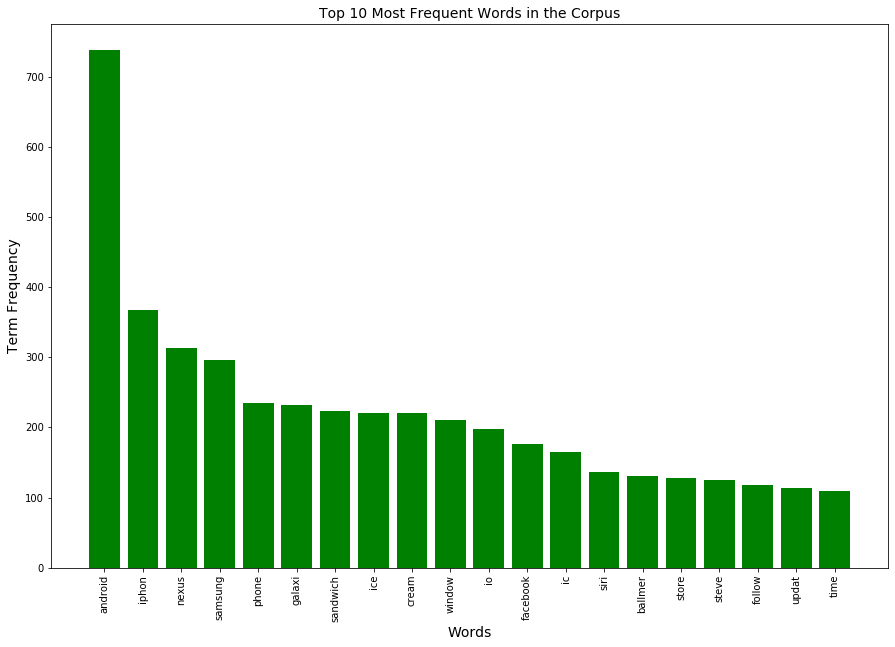

In [27]:
fig, ax = plt.subplots(figsize=(15, 10))
plt.bar(wc_20.index, wc_20[0], color='g')
plt.title("Top 10 Most Frequent Words in the Corpus", fontsize=14)
plt.xlabel('Words', fontsize=14)
plt.ylabel('Term Frequency', fontsize=14)
plt.savefig('media/tf.png')
plt.xticks(rotation=90)

In [28]:
#create dictionary
id2word = gensim.corpora.Dictionary(processed_docs)

#create corpus
texts = processed_docs

#Term Document Frequency
bow_corpus = [id2word.doc2bow(text) for text in texts]

In [29]:
# Human readable format of corpus (term-frequency)
readable_tf = [[(id2word[id], freq) for id, freq in cp] for cp in bow_corpus]

In [30]:
type(id2word)

gensim.corpora.dictionary.Dictionary

In [31]:
lda_model = gensim.models.LdaMulticore(bow_corpus, 
                                       num_topics=12, 
                                       id2word=id2word, 
                                       offset=2, 
                                       passes=20, 
                                       workers=2, 
                                       decay=0.5,
                                       gamma_threshold=2)

# Creating Graph Visualization using Networkx

In [36]:
def visualize_semantic_network(topics, word_based_on_topic, visualize_method="networkx", filename="networkx", title=""):
    #graph = get_semantic_network2(topics, word_based_on_topic)
    graph = get_semantic_network(topics)
    weights = [graph[u][v]['weight'] for u, v in graph.edges()]
    node_size = nx.get_node_attributes(graph, 'importance').values()

    pos = nx.spring_layout(graph)
    
    for node, (x, y) in pos.items():
        graph.node[node]['x'] = float(x)
        graph.node[node]['y'] = float(y)

#     nx.write_graphml(graph, filename)

    #pos = nx.graphviz_layout(graph)
    try:
        pos = graphviz_layout(graph)
    except:
        pos = nx.random_layout(graph)

    nx.draw_networkx_nodes(graph, pos,
                           nodelist = graph.nodes(),
                           #node_color=node_color,
                           node_size=list(node_size),
                           alpha=1)
    # edges
    weights = [weight/10 for weight in weights]
    nx.draw_networkx_edges(graph, pos, width=weights, alpha=0.5)
    nx.draw_networkx_labels(graph, pos, font_size=25, font_color='b')
    fig, ax = plt.subplots(figsize=(100,100))
    nx.draw(graph, pos)
    print('hey')
    plt.savefig('media/graph_testing.png')
    plt.show()

In [37]:
def get_semantic_network(topics):
    graph = nx.Graph()
    for topic in topics:
        for (word1, prob1) in topic:
            for (word2, prob2) in topic:
                if word1 != word2:
                    graph.add_edge(word1, word2, weight=abs(prob1)*abs(prob2)*1000)
                    graph.add_node(word1)#, weight={"importance" : abs(prob1)*100})
                    graph.add_node(word2)#, weight={"importance" : abs(prob2)*100})

    return graph

In [38]:
topics = []
word2id = {v: k for k, v in id2word.items()}
topics_matrix = lda_model.get_topics()

for topic in lda_model.print_topics(num_topics=12, num_words=15):
    topics.append([(item.split('*')[1].replace("\"", "").strip(), float(item.split('*')[0])) for item in topic[1].split('+')])
    print(f'topic:\n{topic}')

word_based_on_topic = {}
for topic in topics:
    for word, _ in topic:
        id = word2id[word]
        word_based_on_topic[word] = topics_matrix[:,id]
        
print(f'word_based_on_topic:\n{word_based_on_topic}')

topic:
(0, '0.032*"samsung" + 0.029*"nexus" + 0.025*"galaxi" + 0.018*"let" + 0.014*"autopilot" + 0.014*"follow" + 0.012*"android" + 0.010*"tweet" + 0.010*"teamfollowback" + 0.010*"aday" + 0.009*"gain" + 0.009*"look" + 0.007*"hze" + 0.007*"tqal" + 0.006*"galaxynexus"')
topic:
(1, '0.017*"si" + 0.015*"xd" + 0.013*"night" + 0.012*"del" + 0.012*"las" + 0.012*"buena" + 0.012*"noch" + 0.011*"goodnight" + 0.010*"pero" + 0.010*"facebook" + 0.010*"go" + 0.009*"una" + 0.009*"mas" + 0.009*"yo" + 0.009*"dormir"')
topic:
(2, '0.016*"siri" + 0.011*"iphon" + 0.010*"build" + 0.010*"io" + 0.009*"start" + 0.009*"peopl" + 0.007*"facebook" + 0.007*"buzz" + 0.006*"game" + 0.006*"chart" + 0.006*"lol" + 0.006*"movement" + 0.006*"work" + 0.006*"news" + 0.006*"fix"')
topic:
(3, '0.010*"thank" + 0.009*"world" + 0.009*"win" + 0.008*"store" + 0.008*"funni" + 0.007*"ok" + 0.007*"great" + 0.007*"aqui" + 0.006*"gt" + 0.006*"friend" + 0.006*"bye" + 0.006*"final" + 0.006*"skype" + 0.006*"man" + 0.005*"cloud"')
topic:


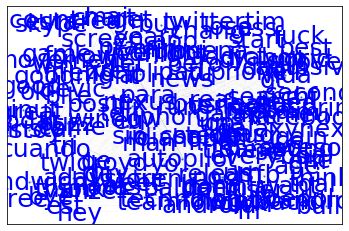

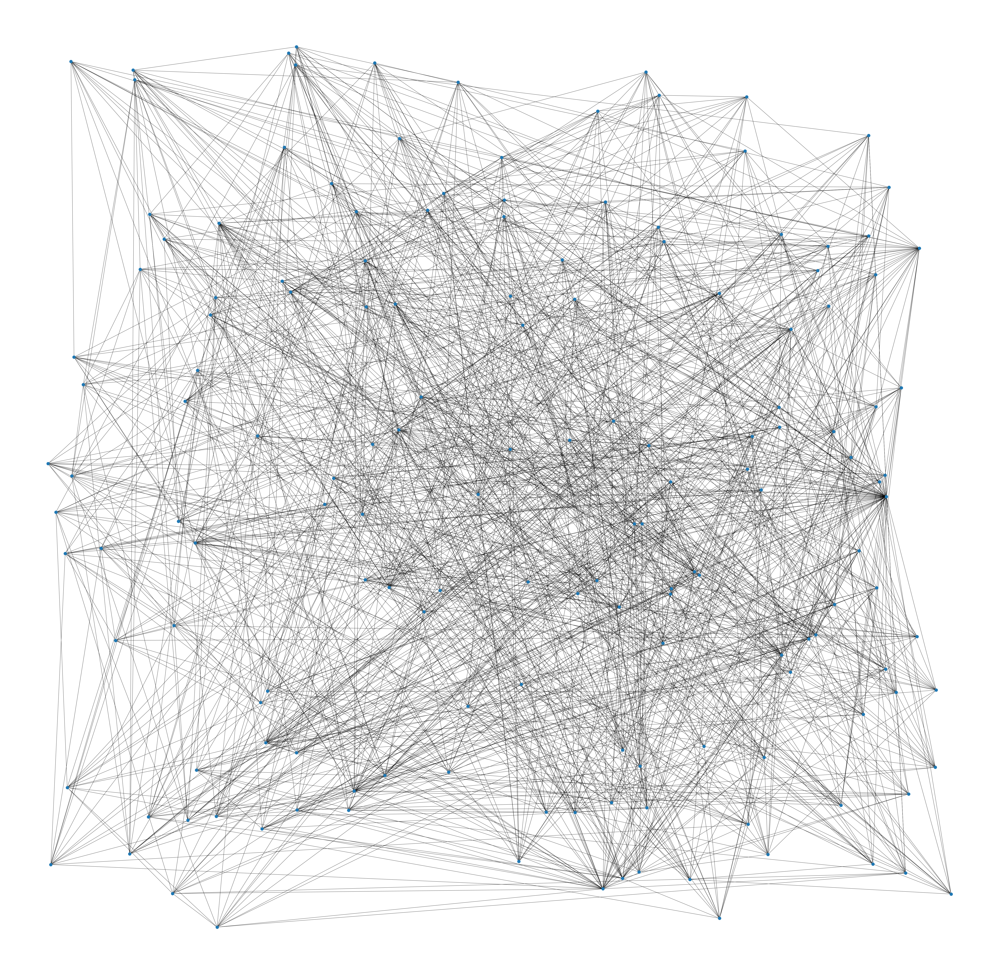

In [39]:
visualize_semantic_network(topics, word_based_on_topic,
                           filename="media/lda_out.graphml",
                           title="Latent Dirichlet Analysis")

# Metrics about Model

In [41]:
from pprint import pprint

# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[bow_corpus]

[(0,
  '0.032*"samsung" + 0.029*"nexus" + 0.025*"galaxi" + 0.018*"let" + '
  '0.014*"autopilot" + 0.014*"follow" + 0.012*"android" + 0.010*"tweet" + '
  '0.010*"teamfollowback" + 0.010*"aday"'),
 (1,
  '0.017*"si" + 0.015*"xd" + 0.013*"night" + 0.012*"del" + 0.012*"las" + '
  '0.012*"buena" + 0.012*"noch" + 0.011*"goodnight" + 0.010*"pero" + '
  '0.010*"facebook"'),
 (2,
  '0.016*"siri" + 0.011*"iphon" + 0.010*"build" + 0.010*"io" + 0.009*"start" + '
  '0.009*"peopl" + 0.007*"facebook" + 0.007*"buzz" + 0.006*"game" + '
  '0.006*"chart"'),
 (3,
  '0.010*"thank" + 0.009*"world" + 0.009*"win" + 0.008*"store" + 0.008*"funni" '
  '+ 0.007*"ok" + 0.007*"great" + 0.007*"aqui" + 0.006*"gt" + 0.006*"friend"'),
 (4,
  '0.069*"android" + 0.028*"sandwich" + 0.027*"cream" + 0.027*"ice" + '
  '0.018*"updat" + 0.010*"nexusprim" + 0.010*"fuck" + 0.010*"nexus" + '
  '0.008*"est" + 0.008*"real"'),
 (5,
  '0.034*"phone" + 0.025*"window" + 0.019*"free" + 0.012*"user" + '
  '0.011*"android" + 0.010*"tri" +

In [52]:
lda_model.get_topics()

array([[1.85933914e-05, 2.85415997e-04, 1.85901281e-05, ...,
        1.85917197e-05, 1.85907375e-05, 1.85919052e-05],
       [1.88999238e-05, 1.12134905e-04, 1.32531350e-04, ...,
        1.73370299e-05, 1.73370354e-05, 1.73372136e-05],
       [1.48597301e-03, 1.06320782e-02, 1.88105041e-05, ...,
        1.88067788e-05, 1.88069716e-05, 1.88072772e-05],
       ...,
       [1.92258449e-05, 3.54786366e-02, 1.92243569e-05, ...,
        1.92210118e-05, 1.92214829e-05, 1.92212319e-05],
       [1.96920682e-05, 7.80756061e-04, 1.96844485e-05, ...,
        6.26329798e-04, 6.26320194e-04, 6.26333291e-04],
       [1.86239977e-05, 1.54381822e-04, 1.86214020e-05, ...,
        1.86223060e-05, 1.86219440e-05, 1.86221259e-05]], dtype=float32)

In [51]:
bow_corpus

[[(0, 1), (1, 2), (2, 1)],
 [(1, 1), (3, 1), (4, 1), (5, 1), (6, 1)],
 [(7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1)],
 [(1, 1), (18, 1), (19, 1), (20, 1)],
 [(21, 1), (22, 1), (23, 1), (24, 1), (25, 1)],
 [(1, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (32, 1)],
 [(14, 2),
  (33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1)],
 [(44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1)],
 [(52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1)],
 [(59, 1), (60, 1), (61, 1), (62, 1)],
 [(14, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1)],
 [(14, 1),
  (63, 1),
  (64, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1)],
 [(46, 1), (74, 1), (75, 1), (76, 1), (77, 1), (78, 1), (79, 1), (80, 1)],
 [(46, 2),
  (49, 1),
  (81, 2),
  (82, 2

In [44]:
for doc in doc_lda:
    print(doc)

[(0, 0.01890655), (1, 0.20938928), (2, 0.31617987), (3, 0.021263564), (4, 0.016839031), (5, 0.019267695), (6, 0.01684263), (7, 0.016844435), (8, 0.01704825), (9, 0.3071029), (10, 0.023032995), (11, 0.017282806)]
[(0, 0.08978846), (1, 0.01624984), (2, 0.23350278), (3, 0.04598679), (4, 0.09891794), (5, 0.06975319), (6, 0.013897028), (7, 0.07777115), (8, 0.013971294), (9, 0.13552807), (10, 0.040656514), (11, 0.16397692)]
[(0, 0.36127856), (1, 0.06400071), (2, 0.11648907), (3, 0.18761808), (4, 0.010995049), (5, 0.014790175), (6, 0.060616188), (7, 0.02671787), (8, 0.021793447), (9, 0.05837498), (10, 0.030600775), (11, 0.046725083)]
[(0, 0.21742247), (1, 0.016875608), (2, 0.104653426), (3, 0.019528268), (4, 0.01670721), (5, 0.018357962), (6, 0.016709464), (7, 0.21672702), (8, 0.016864158), (9, 0.31927887), (10, 0.01987868), (11, 0.01699691)]
[(0, 0.041280188), (1, 0.02064158), (2, 0.10357726), (3, 0.09728451), (4, 0.042607997), (5, 0.02975882), (6, 0.014948487), (7, 0.30011886), (8, 0.020417

[(0, 0.011950749), (1, 0.012090032), (2, 0.23503977), (3, 0.10394619), (4, 0.012217115), (5, 0.08497702), (6, 0.12201214), (7, 0.051097985), (8, 0.14945124), (9, 0.036901668), (10, 0.15476923), (11, 0.025546823)]
[(0, 0.057611495), (1, 0.1894433), (2, 0.098168015), (3, 0.06325047), (4, 0.09666512), (6, 0.09840848), (9, 0.2570035), (10, 0.018049827), (11, 0.098552585)]
[(0, 0.013952064), (1, 0.03502056), (2, 0.19959597), (3, 0.013961841), (4, 0.17748697), (5, 0.013963236), (6, 0.043626975), (7, 0.27031073), (8, 0.013972096), (9, 0.013956745), (10, 0.013976063), (11, 0.19017678)]
[(1, 0.16171087), (2, 0.036240656), (4, 0.08349548), (5, 0.083713435), (7, 0.08728724), (9, 0.2770256), (11, 0.23628002)]
[(0, 0.103980765), (1, 0.050944548), (2, 0.055982437), (3, 0.12426619), (4, 0.015393995), (6, 0.11122975), (7, 0.020646647), (9, 0.39625657), (10, 0.036952037), (11, 0.073087364)]
[(0, 0.017004343), (1, 0.017006638), (2, 0.017004097), (3, 0.017007628), (4, 0.017007904), (5, 0.017005444), (6, 

[(0, 0.013997895), (1, 0.5893785), (2, 0.013997607), (3, 0.013997244), (4, 0.013997057), (5, 0.11580762), (6, 0.013996881), (7, 0.16883697), (8, 0.013997045), (9, 0.013997767), (10, 0.013997626), (11, 0.0139977755)]
[(0, 0.014901038), (1, 0.014115408), (2, 0.081156224), (3, 0.24892832), (4, 0.014011134), (5, 0.022114327), (6, 0.18025446), (7, 0.18123822), (8, 0.018580627), (9, 0.16901273), (10, 0.034745563), (11, 0.020941965)]
[(0, 0.08928508), (1, 0.023591822), (2, 0.018496396), (3, 0.2565288), (4, 0.010317107), (5, 0.2603969), (6, 0.019881094), (7, 0.01344362), (8, 0.013584071), (9, 0.20512511), (10, 0.05254172), (11, 0.036808312)]
[(0, 0.02110198), (1, 0.02110168), (2, 0.025498709), (3, 0.021104183), (4, 0.021101186), (5, 0.023430787), (6, 0.021102259), (7, 0.021102117), (8, 0.021102829), (9, 0.24529642), (10, 0.5369567), (11, 0.021101143)]
[(3, 0.3657665), (4, 0.35222462), (8, 0.024688069), (9, 0.19047539), (10, 0.011511452)]
[(0, 0.015295131), (1, 0.0140744485), (2, 0.036916323), 

[(0, 0.017059008), (1, 0.016678412), (2, 0.14128146), (3, 0.12060987), (4, 0.035793673), (5, 0.032592572), (6, 0.017806046), (7, 0.01667383), (8, 0.022603564), (9, 0.5067011), (10, 0.02831314), (11, 0.04388735)]
[(0, 0.2047654), (1, 0.033030767), (2, 0.02245161), (3, 0.15712132), (5, 0.114120096), (6, 0.07269124), (7, 0.2610709), (8, 0.011654627), (9, 0.029020967), (10, 0.077119194)]
[(0, 0.014452505), (1, 0.014026415), (2, 0.03738267), (3, 0.08188033), (4, 0.0140403155), (5, 0.022619275), (6, 0.01402878), (7, 0.014026372), (8, 0.5162286), (9, 0.06453621), (10, 0.024634693), (11, 0.18214376)]
[(0, 0.0228599), (1, 0.016855406), (2, 0.10339915), (3, 0.017368974), (4, 0.023012275), (5, 0.01685701), (6, 0.2237985), (7, 0.016855258), (8, 0.4103838), (9, 0.087945715), (10, 0.026232783), (11, 0.034431204)]
[(0, 0.1580937), (1, 0.18332975), (3, 0.1900518), (4, 0.022200866), (5, 0.09804198), (8, 0.09823144), (9, 0.19155079), (11, 0.026550004)]
[(0, 0.02026081), (1, 0.012006869), (2, 0.043047428

[(0, 0.036014654), (1, 0.013893792), (2, 0.015117311), (3, 0.014132736), (4, 0.6339244), (5, 0.028547011), (6, 0.021850925), (7, 0.18037741), (8, 0.013893509), (9, 0.014460104), (10, 0.013894236), (11, 0.013893875)]
[(0, 0.08207403), (1, 0.20540114), (2, 0.049005732), (3, 0.040696204), (4, 0.11879414), (5, 0.095615245), (6, 0.2139611), (7, 0.06516472), (9, 0.10446415)]
[(0, 0.21397963), (1, 0.01391044), (2, 0.013910799), (3, 0.013915279), (4, 0.030082298), (5, 0.013910344), (6, 0.29727826), (7, 0.18058118), (8, 0.014573091), (9, 0.013947806), (10, 0.013910558), (11, 0.18000033)]
[(0, 0.010460045), (1, 0.010441888), (2, 0.14511093), (3, 0.0104421275), (4, 0.38511992), (5, 0.010441879), (6, 0.010442851), (7, 0.12882367), (8, 0.13262272), (9, 0.010559185), (10, 0.01044179), (11, 0.13509299)]
[(0, 0.047443196), (1, 0.096183695), (2, 0.05092815), (3, 0.103945196), (4, 0.33910465), (5, 0.1023689), (6, 0.014039824), (8, 0.08326635), (9, 0.11872989), (10, 0.027593458)]
[(0, 0.15931524), (1, 0.

[(0, 0.2447201), (1, 0.20628893), (2, 0.05682367), (3, 0.1482424), (4, 0.09778895), (5, 0.12964243), (9, 0.04820195), (10, 0.03099299)]
[(0, 0.14233623), (2, 0.2926826), (4, 0.106145285), (5, 0.10697233), (6, 0.013391202), (7, 0.16324711), (9, 0.1360464)]
[(0, 0.16812867), (1, 0.074435495), (2, 0.097566836), (4, 0.4130984), (5, 0.08171487), (11, 0.12433207)]
[(0, 0.14507341), (2, 0.1310388), (4, 0.4709528), (5, 0.09019963), (9, 0.01519691), (10, 0.011759759), (11, 0.099686556)]
[(0, 0.12522732), (2, 0.18869434), (4, 0.47004747), (5, 0.077851176), (9, 0.011439589), (11, 0.0859252)]
[(0, 0.10096351), (1, 0.013988041), (2, 0.013987619), (3, 0.013988252), (4, 0.013987138), (5, 0.013987785), (6, 0.013988151), (7, 0.24332139), (8, 0.013987532), (9, 0.01398822), (10, 0.013988383), (11, 0.52982396)]
[(0, 0.054553792), (3, 0.044609915), (4, 0.63189656), (5, 0.111987635), (6, 0.014504947), (9, 0.09539725)]
[(0, 0.2753809), (4, 0.2790498), (5, 0.014478513), (6, 0.19534123), (8, 0.017081201), (9, 

[(0, 0.021109898), (1, 0.26295677), (2, 0.013804361), (3, 0.031547725), (4, 0.02399341), (5, 0.38093343), (6, 0.010549782), (7, 0.023547892), (8, 0.13577975), (9, 0.07015946), (10, 0.015125219), (11, 0.01049228)]
[(1, 0.020148782), (5, 0.028109929), (6, 0.13520166), (7, 0.4676982), (9, 0.21451291), (10, 0.091037415)]
[(0, 0.08901312), (1, 0.026089557), (2, 0.04014773), (3, 0.01226936), (4, 0.06985145), (5, 0.011943377), (6, 0.38749263), (7, 0.012093541), (8, 0.011937564), (9, 0.17242956), (10, 0.011937407), (11, 0.15479468)]
[(0, 0.020448908), (1, 0.07903074), (2, 0.08476026), (3, 0.24484433), (5, 0.38990286), (7, 0.049667697), (10, 0.07968305), (11, 0.023128703)]
[(0, 0.13834566), (1, 0.33231905), (2, 0.01159768), (4, 0.4173785), (5, 0.023775406), (6, 0.018931143)]
[(0, 0.073398925), (1, 0.020595735), (2, 0.10977015), (3, 0.023280954), (4, 0.2619804), (5, 0.022155993), (6, 0.16815121), (7, 0.022062812), (9, 0.26722497), (10, 0.020246156)]
[(0, 0.036919903), (1, 0.016883126), (2, 0.018

[(0, 0.06807765), (1, 0.02817776), (2, 0.030690033), (3, 0.028676962), (4, 0.5895398), (5, 0.06822277), (6, 0.044532623), (7, 0.02825811), (8, 0.02817609), (9, 0.029292613), (10, 0.02818021), (11, 0.028175352)]
[(0, 0.26946673), (1, 0.23840778), (2, 0.078486376), (4, 0.14432786), (5, 0.06963457), (6, 0.110457934), (7, 0.01558325), (8, 0.04395515)]
[(0, 0.11873234), (2, 0.060142078), (3, 0.07250881), (4, 0.25176722), (5, 0.20275074), (6, 0.061761152), (8, 0.07182267), (9, 0.08169285), (10, 0.054437358), (11, 0.013151011)]
[(4, 0.6498974), (5, 0.3004334)]
[(0, 0.50557274), (2, 0.01002422), (3, 0.22869198), (4, 0.1644434), (5, 0.019492619), (6, 0.01543445)]
[(0, 0.120350584), (2, 0.027183108), (4, 0.4421323), (5, 0.0131770065), (6, 0.07252443), (7, 0.25462812), (9, 0.039940648)]
[(0, 0.027318157), (1, 0.030333314), (2, 0.054816253), (4, 0.3816269), (5, 0.02853796), (6, 0.055327658), (7, 0.03254737), (9, 0.053440966), (10, 0.30483335), (11, 0.013946881)]
[(0, 0.17727993), (1, 0.091289766),

[(0, 0.24309261), (1, 0.010481492), (2, 0.010482312), (3, 0.039865773), (4, 0.010481809), (5, 0.09289561), (6, 0.010481703), (7, 0.010481949), (8, 0.01048567), (9, 0.027524592), (10, 0.5232442), (11, 0.0104822265)]
[(0, 0.1053979), (1, 0.021124711), (2, 0.010984311), (3, 0.16779096), (5, 0.4826816), (6, 0.0633956), (8, 0.016791718), (11, 0.09937261)]
[(0, 0.021017505), (1, 0.021399792), (2, 0.02101809), (3, 0.021018174), (4, 0.5228893), (5, 0.021022005), (6, 0.021386249), (7, 0.021017656), (8, 0.021017672), (9, 0.2651525), (10, 0.021019625), (11, 0.022041388)]
[(0, 0.01539674), (1, 0.09806553), (3, 0.08591991), (4, 0.28938612), (5, 0.098833054), (9, 0.12517484), (10, 0.100163214), (11, 0.15626955)]
[(0, 0.01135268), (1, 0.13080364), (2, 0.25521648), (3, 0.010477998), (4, 0.13713609), (5, 0.010478852), (6, 0.016529553), (7, 0.016073463), (8, 0.254746), (9, 0.010477445), (10, 0.010985493), (11, 0.13572231)]
[(0, 0.015107227), (1, 0.020382175), (2, 0.18183981), (3, 0.4364673), (4, 0.03027

[(3, 0.20577827), (6, 0.017905796), (7, 0.11482222), (8, 0.06561714), (9, 0.027813544), (10, 0.21428904), (11, 0.31178454)]
[(2, 0.16774097), (3, 0.102386795), (4, 0.076760225), (5, 0.022478843), (7, 0.011189411), (8, 0.44784302), (9, 0.0154391965), (10, 0.033739608), (11, 0.09427254)]
[(3, 0.120405756), (6, 0.021211859), (7, 0.12500708), (8, 0.06976499), (9, 0.033115733), (10, 0.23793752), (11, 0.34608746)]
[(0, 0.023935825), (2, 0.11830911), (3, 0.18496184), (4, 0.024719039), (5, 0.014869321), (6, 0.23269081), (7, 0.010312707), (8, 0.2251188), (9, 0.012108076), (10, 0.13084571), (11, 0.012150369)]
[(0, 0.022359936), (1, 0.11962457), (2, 0.16384245), (3, 0.09334258), (8, 0.09763148), (9, 0.10997184), (10, 0.14772102), (11, 0.2101018)]
[(0, 0.019257799), (2, 0.04901398), (3, 0.02014547), (4, 0.085656755), (8, 0.19390719), (9, 0.4066384), (10, 0.022699676), (11, 0.17525801)]
[(0, 0.010496447), (1, 0.011815524), (2, 0.010495884), (3, 0.1658805), (4, 0.2118827), (5, 0.011074646), (6, 0.13

[(0, 0.07749867), (1, 0.08050925), (2, 0.021077046), (3, 0.058227826), (4, 0.08905573), (5, 0.20026623), (7, 0.36491454), (11, 0.082519285)]
[(0, 0.1802567), (1, 0.014069868), (2, 0.07782791), (3, 0.014070166), (4, 0.01811282), (5, 0.014067457), (6, 0.5286309), (7, 0.08920309), (8, 0.01412433), (9, 0.01406937), (10, 0.014069338), (11, 0.021498095)]
[(0, 0.084142715), (1, 0.015907053), (2, 0.083730884), (3, 0.16894017), (6, 0.3089546), (7, 0.08381118), (9, 0.08368972), (10, 0.14292048)]
[(5, 0.040409975), (8, 0.3751709), (9, 0.056494094), (10, 0.4665134)]
[(0, 0.0833771), (1, 0.08634795), (2, 0.030681256), (3, 0.06210843), (4, 0.017902583), (5, 0.22044966), (7, 0.38163626), (11, 0.089522846)]
[(0, 0.014237829), (1, 0.12946634), (2, 0.11159075), (3, 0.09831522), (5, 0.11830989), (7, 0.45662132), (8, 0.011551803), (11, 0.028994234)]
[(0, 0.7207362), (1, 0.0121494755), (2, 0.012150995), (3, 0.012151482), (4, 0.012150424), (5, 0.012149543), (6, 0.012150177), (7, 0.012149765), (8, 0.01215070

[(1, 0.277098), (5, 0.110447414), (6, 0.14288193), (8, 0.010922479), (9, 0.39786494)]
[(0, 0.0385317), (2, 0.02309683), (4, 0.19581383), (5, 0.02849824), (6, 0.016289962), (7, 0.3323219), (8, 0.320983), (9, 0.015823865)]
[(2, 0.12129991), (6, 0.10767316), (8, 0.6861605)]
[(0, 0.09209467), (1, 0.4411574), (2, 0.09223116), (6, 0.061890278), (9, 0.08134365), (11, 0.18619478)]
[(0, 0.010591262), (1, 0.021919835), (2, 0.012494566), (3, 0.08267096), (5, 0.014450115), (6, 0.040668707), (7, 0.7501676), (8, 0.028790234), (11, 0.0143779805)]
[(0, 0.030029204), (1, 0.7411983), (3, 0.030217236), (4, 0.028650943), (5, 0.015956827), (8, 0.056297906), (10, 0.065751985)]
[(0, 0.015515402), (2, 0.044660203), (3, 0.033738073), (5, 0.8496214)]
[(0, 0.015419428), (2, 0.05034237), (3, 0.0292391), (5, 0.84350115)]
[(1, 0.013329079), (2, 0.072976716), (6, 0.36310595), (8, 0.14156234), (9, 0.03148131), (10, 0.073755905), (11, 0.27109954)]
[(0, 0.013211639), (1, 0.010615524), (2, 0.010619174), (3, 0.010618322)

[(0, 0.02085533), (1, 0.06723324), (2, 0.057537626), (3, 0.020856436), (4, 0.033257592), (5, 0.020855295), (6, 0.0730765), (7, 0.38133374), (8, 0.020855222), (9, 0.020855306), (10, 0.020855226), (11, 0.26242846)]
[(0, 0.04174606), (1, 0.04174622), (2, 0.04174629), (3, 0.041746), (4, 0.041746125), (5, 0.041746322), (6, 0.540792), (7, 0.041746154), (8, 0.041746277), (9, 0.04174632), (10, 0.041746043), (11, 0.041746177)]
[(0, 0.011986301), (1, 0.011986073), (2, 0.0119866105), (3, 0.27347592), (4, 0.15636262), (5, 0.3136596), (6, 0.015795963), (7, 0.013304581), (8, 0.011985883), (9, 0.011986821), (10, 0.0119862845), (11, 0.15548332)]
[(0, 0.020965824), (1, 0.020965202), (2, 0.020966128), (3, 0.05984048), (4, 0.020965166), (5, 0.020965995), (6, 0.2335368), (7, 0.51793224), (8, 0.020966062), (9, 0.020965137), (10, 0.020965358), (11, 0.020965574)]
[(0, 0.20117727), (1, 0.09064498), (2, 0.016174372), (4, 0.09212841), (7, 0.12002392), (9, 0.04639015), (10, 0.09929446), (11, 0.30354685)]
[(0, 0.

[(0, 0.016707659), (1, 0.016691502), (2, 0.43722576), (3, 0.16985686), (4, 0.18326491), (5, 0.01669158), (6, 0.016691456), (7, 0.016691433), (8, 0.053928975), (9, 0.016691448), (10, 0.036071572), (11, 0.019486858)]
[(0, 0.011924469), (1, 0.011923447), (2, 0.8688404), (3, 0.0119235935), (4, 0.011923471), (5, 0.011923524), (6, 0.0119234165), (7, 0.0119235655), (8, 0.011923551), (9, 0.011923426), (10, 0.011923655), (11, 0.011923521)]
[(0, 0.057062052), (1, 0.010510241), (2, 0.7673938), (3, 0.07882662), (4, 0.010428971), (5, 0.010429007), (6, 0.010429132), (7, 0.010429213), (8, 0.010429085), (9, 0.010429521), (10, 0.010451412), (11, 0.013180913)]
[(0, 0.60325), (1, 0.05383954), (2, 0.043476757), (3, 0.018251112), (4, 0.013912345), (5, 0.013451755), (6, 0.13720769), (7, 0.019854046), (8, 0.01630519), (9, 0.014496978), (10, 0.029043464), (11, 0.03691109)]
[(0, 0.1257265), (1, 0.01525754), (2, 0.080596805), (3, 0.1719285), (4, 0.01236763), (5, 0.32576945), (6, 0.011933351), (7, 0.1884941), (8

[(0, 0.027669713), (1, 0.78200924), (2, 0.010450022), (3, 0.077299714), (4, 0.010450147), (5, 0.010449746), (6, 0.010450456), (7, 0.010450102), (8, 0.010450031), (9, 0.018678494), (10, 0.021192478), (11, 0.010449888)]
[(0, 0.010117289), (1, 0.4373549), (2, 0.025597965), (6, 0.08131876), (7, 0.092088856), (8, 0.29124036), (9, 0.01667196), (11, 0.012479239)]
[(0, 0.010447469), (1, 0.010697681), (2, 0.010456729), (3, 0.010991301), (4, 0.010447384), (5, 0.019751668), (6, 0.03663193), (7, 0.03724694), (8, 0.7781347), (9, 0.02037959), (10, 0.016781012), (11, 0.03803359)]
[(1, 0.14480892), (2, 0.015974147), (3, 0.17676061), (5, 0.55187756), (6, 0.017489072), (7, 0.038692214), (9, 0.010306006)]
[(11, 0.95802826)]
[(0, 0.014990673), (2, 0.076603815), (3, 0.040301245), (4, 0.040361866), (6, 0.06209671), (7, 0.49746713), (9, 0.050937258), (10, 0.10724306), (11, 0.0860058)]
[(0, 0.1857551), (2, 0.04697656), (4, 0.013348357), (6, 0.017388655), (7, 0.14835343), (8, 0.5439649)]
[(1, 0.027390778), (5,

[(0, 0.04167201), (1, 0.5415358), (2, 0.04167203), (3, 0.04167201), (4, 0.04167203), (5, 0.041681293), (6, 0.0416721), (7, 0.04167265), (8, 0.04167201), (9, 0.041672036), (10, 0.041734017), (11, 0.041672025)]
[(0, 0.56134015), (1, 0.040754445), (2, 0.020415198), (4, 0.046673607), (5, 0.014487334), (6, 0.15345195), (7, 0.047176264), (8, 0.011956495), (9, 0.018375134), (10, 0.06839763), (11, 0.010983143)]
[(0, 0.020838032), (1, 0.769368), (2, 0.020838073), (3, 0.020838073), (4, 0.020838065), (5, 0.020841751), (6, 0.02219404), (7, 0.020838326), (8, 0.020838061), (9, 0.020838046), (10, 0.020891495), (11, 0.020838046)]
[(0, 0.011954798), (1, 0.011954664), (2, 0.011954669), (3, 0.011954712), (4, 0.011954693), (5, 0.011954731), (6, 0.86849904), (7, 0.011954873), (8, 0.0119541325), (9, 0.011954543), (10, 0.011954774), (11, 0.011954349)]
[(0, 0.028060408), (1, 0.10490238), (2, 0.087734334), (3, 0.57373726), (5, 0.047916885), (6, 0.03445702), (7, 0.01320045), (8, 0.03503318), (9, 0.011748606), (

In [120]:
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(bow_corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=processed_docs, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -11.198209205838852

Coherence Score:  0.48749894443202485


In [41]:
doc_array

array([list(['swype', 'iphon', 'crack', 'iphon']),
       list(['add', 'carrier', 'support', 'iphon', 'announc']),
       list(['hilari', 'youtub', 'video', 'guy', 'duet', 'siri', 'pretti', 'sum', 'love', 'affair', 'exbnqji']),
       ...,
       list(['tien', 'mala', 'costumbr', 'ponerc', 'bno', 'cuano', 'yo', 'voy']),
       list(['oi', 'flaviasansi', 'muito', 'bem', 'vinda', 'ao', 'meu', 'sempr', 'dou', 'followback', 'pelo', 'meu', 'perfil', 'profission', 'permaneca', 'por', 'aqui', 'certo', 'abrass']),
       list(['ele', 'arrastaram', 'os', 'barco', 'para', 'praia', 'deixaram', 'tudo', 'seguiram', 'jesus', 'luca', 'est', 'foii', 'primeiro', 'da', 'historia', 'humana'])],
      dtype=object)

# Coherence Plot

In [36]:
def create_id2word(data):
    '''
    '''
    return corpora.Dictionary(data)


def create_corpus(id2word, data):
    '''
    '''
    return [id2word.doc2bow(text) for text in data]


def compute_coherence_values(texts, start=2, stop=30, step=3):
    """
    Compute c_v coherence for various number of topics
    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics
    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with
                       respective number of topics
    """
    coherence_values = []
    model_list = []

    id2word = create_id2word(texts)
    corpus = create_corpus(id2word, texts)

    for num_topics in range(start, stop, step):
        print('Calculating {}-topic model'.format(num_topics))
        model = gensim.models.LdaMulticore(bow_corpus, num_topics=4, id2word=id2word, passes=5, workers=2)
#         model = gensim.models.wrappers.LdaMallet(mallet_path,
#                                                  corpus=corpus,
#                                                  num_topics=num_topics,
#                                                  id2word=id2word)
        model_list.append((num_topics, model))
        coherencemodel = CoherenceModel(model=model,
                                        texts=texts,
                                        dictionary=id2word,
                                        coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values, id2word, corpus

Calculating 2-topic model
Calculating 5-topic model
Calculating 8-topic model
Calculating 11-topic model
Calculating 14-topic model
Calculating 17-topic model
Calculating 20-topic model
Calculating 23-topic model
Calculating 26-topic model
Calculating 29-topic model


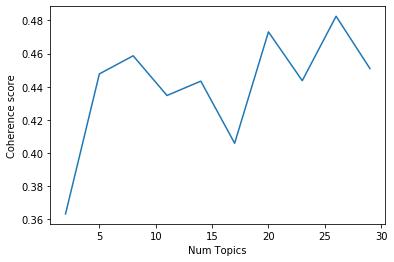

In [40]:
start=2
stop=30
step=3
stop += 1
(model_list,
 coherence_values,
 id2word,
 corpus) = compute_coherence_values(texts=doc_array,
                                            start=start,
                                            stop=stop,
                                            step=step)

# Show graph
x = range(start, stop, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
# plt.legend(("coherence_values"), loc='best')
plt.show()

In [121]:
bow_corpus

[[(0, 1), (1, 2), (2, 1)],
 [(1, 1), (3, 1), (4, 1), (5, 1), (6, 1)],
 [(7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 1),
  (15, 1),
  (16, 1),
  (17, 1)],
 [(1, 1), (18, 1), (19, 1), (20, 1), (21, 1)],
 [(22, 1), (23, 1), (24, 1), (25, 1), (26, 1)],
 [(1, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (32, 1), (33, 1)],
 [(14, 2),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1),
  (44, 1)],
 [(45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1)],
 [(53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1)],
 [(60, 1), (61, 1), (62, 1), (63, 1)],
 [(14, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1)],
 [(14, 1),
  (64, 1),
  (65, 1),
  (67, 1),
  (68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1)],
 [(47, 1), (75, 1), (76, 1), (77, 1), (78, 1), (79, 1), (80, 1), (81, 1)],
 [(47, 2),
  (50, 1),
  (82, 2),

## Making Bigrams

In [45]:
def make_bigrams(texts):
    '''
    '''
    data_words = texts
    # higher threshold fewer phrases.
    bigram = gensim.models.Phrases(data_words, min_count=5, threshold=100)
    bigram_mod = gensim.models.phrases.Phraser(bigram)
    return [bigram_mod[doc] for doc in texts]

In [50]:
# doc_array
bigram = make_bigrams(doc_array)
bigram

[['swype', 'iphon', 'crack', 'iphon'],
 ['add', 'carrier', 'support', 'iphon', 'announc'],
 ['hilari',
  'youtub',
  'video',
  'guy',
  'duet',
  'siri',
  'pretti',
  'sum',
  'love',
  'affair',
  'exbnqji'],
 ['rim', 'easi', 'switch', 'iphon', 'ya'],
 ['realiz', 'reason', 'get', 'io', 'thank'],
 ['current',
  'blackberri',
  'user',
  'littl',
  'bite',
  'disappoint',
  'android',
  'iphon'],
 ['strangest',
  'thing',
  'siri',
  'say',
  'far',
  'sooo',
  'glad',
  'give',
  'siri',
  'sens',
  'humor',
  'twaeudbp',
  'happyplac'],
 ['great', 'close', 'person', 'event', 'tonight', 'regent', 'st', 'store'],
 ['compani', 'experi', 'best', 'custom_servic', 'asid', 'zappo'],
 ['appli', 'job', 'hope', 'lol'],
 ['jamaicanidl',
  'lmao',
  'think',
  'magic',
  'die',
  'haha',
  'siri',
  'suggest',
  'whore'],
 ['lmao',
  'think',
  'magic',
  'die',
  'haha',
  'siri',
  'suggest',
  'whore',
  'hide',
  'bodi',
  'lolol'],
 ['philliprowntre',
  'regist',
  'develop',
  'hop',
  'a

In [142]:
doc_tops = lda_model.get_document_topics(bow_corpus)
doc_dist = []
doc_loads = []
for doc_top in doc_tops:
    doc_dist.append([tup[1] for tup in doc_top])
    doc_loads.append([tup[0] for tup in doc_top])
doc_dist

[[0.05059773, 0.051847074, 0.8473653, 0.05018987],
 [0.042583164, 0.04339477, 0.87165123, 0.042370837],
 [0.021884864, 0.021899238, 0.9351619, 0.021053953],
 [0.41839233, 0.49538106, 0.04276135, 0.04346523],
 [0.661169, 0.043906357, 0.25274715, 0.042177532],
 [0.16012953, 0.029249288, 0.78262806, 0.027993053],
 [0.018005228, 0.019033087, 0.63599885, 0.3269629],
 [0.02853202, 0.02980296, 0.91328716, 0.02837791],
 [0.031913534, 0.542472, 0.39394477, 0.031669647],
 [0.41180003, 0.052803207, 0.48320678, 0.052189987],
 [0.2966435, 0.6470431, 0.026430612, 0.02988283],
 [0.20385131, 0.59498644, 0.17942233, 0.021739937],
 [0.9133477, 0.028930916, 0.029542094, 0.028179238],
 [0.09696245, 0.8703044, 0.016701316, 0.016031817],
 [0.9018977, 0.03275262, 0.03360331, 0.031746347],
 [0.016185727, 0.016634846, 0.95114124, 0.01603816],
 [0.022702612, 0.79627347, 0.15797351, 0.02305041],
 [0.025805024, 0.9230149, 0.025788626, 0.025391506],
 [0.033323675, 0.032110088, 0.9014639, 0.03310232],
 [0.019018702

In [134]:
topic_of_doc = []
for doc in doc_dist:
    topic_of_doc.append(np.argmax(doc))
topic_of_doc

[2,
 2,
 2,
 1,
 0,
 2,
 2,
 2,
 1,
 2,
 1,
 1,
 0,
 1,
 0,
 2,
 1,
 1,
 2,
 2,
 0,
 2,
 2,
 2,
 2,
 2,
 2,
 1,
 1,
 2,
 0,
 1,
 1,
 2,
 1,
 1,
 0,
 2,
 2,
 2,
 2,
 1,
 1,
 1,
 2,
 1,
 1,
 3,
 2,
 2,
 2,
 2,
 2,
 1,
 1,
 1,
 0,
 0,
 1,
 2,
 1,
 1,
 1,
 1,
 2,
 2,
 1,
 2,
 2,
 3,
 3,
 1,
 1,
 1,
 0,
 2,
 2,
 2,
 1,
 2,
 0,
 1,
 0,
 0,
 2,
 0,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 1,
 1,
 0,
 2,
 1,
 3,
 0,
 3,
 2,
 3,
 1,
 2,
 2,
 2,
 1,
 1,
 1,
 2,
 3,
 2,
 2,
 0,
 0,
 1,
 2,
 2,
 3,
 2,
 1,
 1,
 2,
 0,
 2,
 2,
 2,
 1,
 3,
 1,
 1,
 2,
 2,
 0,
 2,
 1,
 2,
 2,
 2,
 2,
 1,
 3,
 0,
 1,
 2,
 2,
 0,
 2,
 0,
 0,
 1,
 2,
 2,
 0,
 1,
 0,
 0,
 2,
 2,
 2,
 2,
 3,
 1,
 1,
 2,
 2,
 2,
 1,
 1,
 1,
 0,
 2,
 2,
 2,
 0,
 3,
 0,
 0,
 1,
 0,
 1,
 3,
 2,
 2,
 2,
 2,
 2,
 2,
 1,
 1,
 1,
 3,
 1,
 1,
 2,
 2,
 0,
 2,
 0,
 2,
 1,
 0,
 1,
 1,
 2,
 1,
 0,
 0,
 0,
 0,
 2,
 2,
 1,
 0,
 1,
 1,
 1,
 0,
 2,
 1,
 2,
 1,
 1,
 1,
 2,
 0,
 2,
 1,
 1,
 1,
 2,
 1,
 3,
 2,
 1,
 1,
 2,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 1,


In [137]:
print(processed_docs[40])
print(topic_of_doc[40])

['download', 'io', 'prove', 'popular', 'user', 'nshlfiux']
2


In [16]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, bow_corpus, id2word, mds='mmds')
pyLDAvis.save_html(vis, 'media/LDA_4_topics.html')

/home/jarid/anaconda3/lib/python3.7/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


## KMeans Clustering

In [141]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

In [142]:
documents = twitter['TweetText'].values
documents = list(documents)
documents

['Now all @Apple has to do is get swype on the iphone and it will be crack. Iphone that is',
 '@Apple will be adding more carrier support to the iPhone 4S (just announced)',
 "Hilarious @youtube video - guy does a duet with @apple 's Siri. Pretty much sums up the love affair! http://t.co/8ExbnQjY",
 '@RIM you made it too easy for me to switch to @Apple iPhone. See ya!',
 'I just realized that the reason I got into twitter was ios5 thanks @apple',
 "I'm a current @Blackberry user, little bit disappointed with it! Should I move to @Android or @Apple @iphone",
 'The 16 strangest things Siri has said so far. I am SOOO glad that @Apple gave Siri a sense of humor! http://t.co/TWAeUDBp via @HappyPlace',
 'Great up close & personal event @Apple tonight in Regent St store!',
 'From which companies do you experience the best customer service aside from @zappos and @apple?',
 'Just apply for a job at @Apple, hope they call me lol',
 'RT @JamaicanIdler: Lmao I think @apple is onto something magica

In [143]:
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(documents)
X = X.toarray()

In [144]:
true_k = 4
model = KMeans(n_clusters=true_k, init='k-means++', max_iter=100, n_init=1)
model.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
       n_clusters=4, n_init=1, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [145]:
print("Top terms per cluster:")
order_centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()
for i in range(true_k):
    print("Cluster %d:" % i),
    for ind in order_centroids[i, :10]:
        print(' %s' % terms[ind]),
    print

Top terms per cluster:
Cluster 0:
 twitter
 rt
 facebook
 que
 en
 el
 http
 la
 es
 goodnight
Cluster 1:
 android
 google
 nexus
 sandwich
 cream
 ice
 samsung
 galaxy
 http
 ics
Cluster 2:
 apple
 iphone
 siri
 http
 ios5
 store
 4s
 new
 ios
 iphone4s
Cluster 3:
 microsoft
 http
 google
 rt
 windows
 android
 ballmer
 yahoo
 en
 nexusprime


In [146]:
Y = vectorizer.transform(["chrome is my go to browser."])
prediction = model.predict(Y)
print(prediction)

[3]


In [147]:
Y = vectorizer.transform(["I love my iphone."])
prediction = model.predict(Y)
print(prediction)

[2]


In [150]:
Y = vectorizer.transform(["I prefer to use android"])
prediction = model.predict(Y)
print(prediction)

[3]


In [149]:
Y = vectorizer.transform(["I think Google is the best"])
prediction = model.predict(Y)
print(prediction)

[3]


# Gensim Examples

In [51]:
import gensim.downloader as api
from gensim.models import TfidfModel
from gensim.corpora import Dictionary

dataset = api.load("text8")
dct = Dictionary(dataset)  # fit dictionary
corpus = [dct.doc2bow(line) for line in dataset]  # convert corpus to BoW format

model = TfidfModel(corpus)  # fit model
vector = model[corpus[0]]  # apply model to the first corpus document

[==================================================] 100.0% 31.6/31.6MB downloaded


In [52]:
dataset

In [53]:
dct

In [54]:
vector

[(1, 0.006704047545684609),
 (2, 0.0030255603220721273),
 (3, 0.003156168449586299),
 (4, 0.0036673470201144674),
 (5, 0.004575122435127926),
 (6, 0.0028052608258295926),
 (7, 0.004064820137019515),
 (8, 0.00014963587508918375),
 (9, 0.0007492665180478759),
 (10, 0.004142807322609117),
 (11, 0.004149816941645728),
 (12, 0.0077498817493309525),
 (13, 0.00656024165742503),
 (14, 0.003891486499758776),
 (15, 0.005476877392392166),
 (16, 0.0018233938817994433),
 (17, 0.0032209070754237084),
 (18, 0.0017737283389229173),
 (19, 0.0023373507198140124),
 (20, 0.003725514968930464),
 (21, 0.00590342512385848),
 (22, 0.003072401062545206),
 (23, 0.0006668171096292247),
 (24, 0.0017594266221832493),
 (25, 0.004202080158963513),
 (26, 0.002967397324595724),
 (27, 0.004709756138185673),
 (28, 0.0014819657487289912),
 (29, 0.0031562459553171694),
 (30, 0.0031999829254611097),
 (31, 0.001215574949729317),
 (32, 0.003843126241898761),
 (33, 0.006499414537896336),
 (34, 0.004546489373863172),
 (35, 0.0